In [5]:
!pip install diffusers transformers accelerate
!pip install huggingface_hub

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
from huggingface_hub import notebook_login

# Login to Hugging Face Hub
notebook_login()

In [17]:
# Import pustaka yang diperlukan
import torch
from diffusers import StableDiffusion3Pipeline
from IPython.display import display, Image
import datetime
import random
import os

# Inisialisasi pipeline
model_id = "stabilityai/stable-diffusion-3-medium-diffusers"
pipe = StableDiffusion3Pipeline.from_pretrained(
    model_id,
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
    memory_efficient_attention=True,
    text_encoder_3=None,
    tokenizer_3=None,
)
pipe.enable_model_cpu_offload()

torch.cuda.empty_cache()
pipe.enable_attention_slicing()
pipe = pipe.to("cuda")

Keyword arguments {'memory_efficient_attention': True} are not expected by StableDiffusion3Pipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

It seems like you have activated model offloading by calling `enable_model_cpu_offload`, but are now manually moving the pipeline to GPU. It is strongly recommended against doing so as memory gains from offloading are likely to be lost. Offloading automatically takes care of moving the individual components vae, text_encoder, text_encoder_2, text_encoder_3, tokenizer, tokenizer_2, tokenizer_3, transformer, scheduler to GPU when needed. To make sure offloading works as expected, you should consider moving the pipeline back to CPU: `pipeline.to('cpu')` or removing the move altogether if you use offloading.


In [46]:
def generate_image(pipe, prompt, image_path):
    print(f"Generating image for prompt: {prompt}")

    with torch.no_grad():
      torch.manual_seed(random.randint(0, 1000))

      image = pipe(
          prompt=prompt,
          negative_prompt="",
          num_inference_steps=50,
          width=1280,
          height=720,
          guidance_scale=7.5,
          num_images_per_prompt=1,
      ).images[0]
    # Menyimpan gambar
    image.save(image_path)

    # Clear the PyTorch cache
    torch.cuda.empty_cache()

    return image_path

Generating image for prompt: montain landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

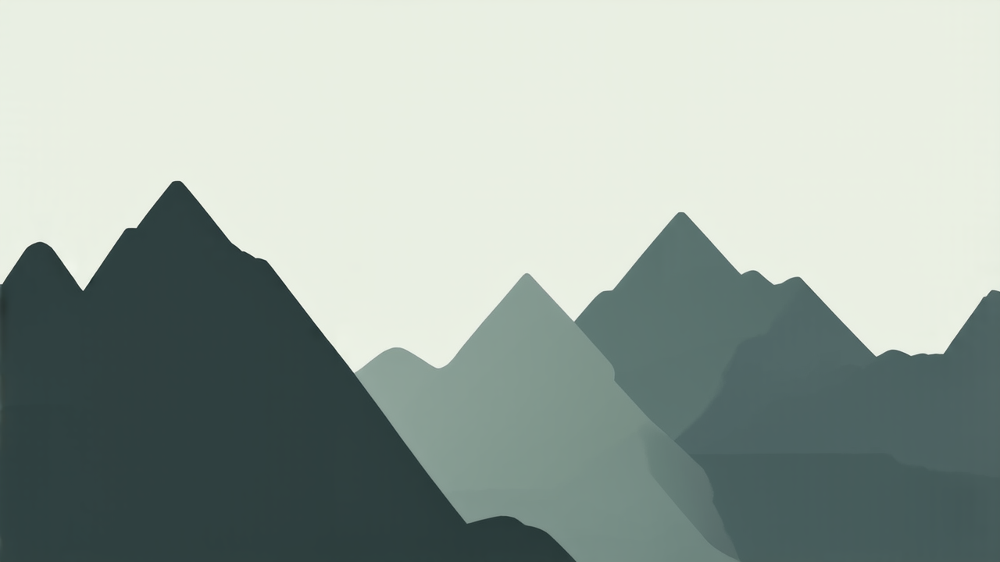

Generating image for prompt: misty landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

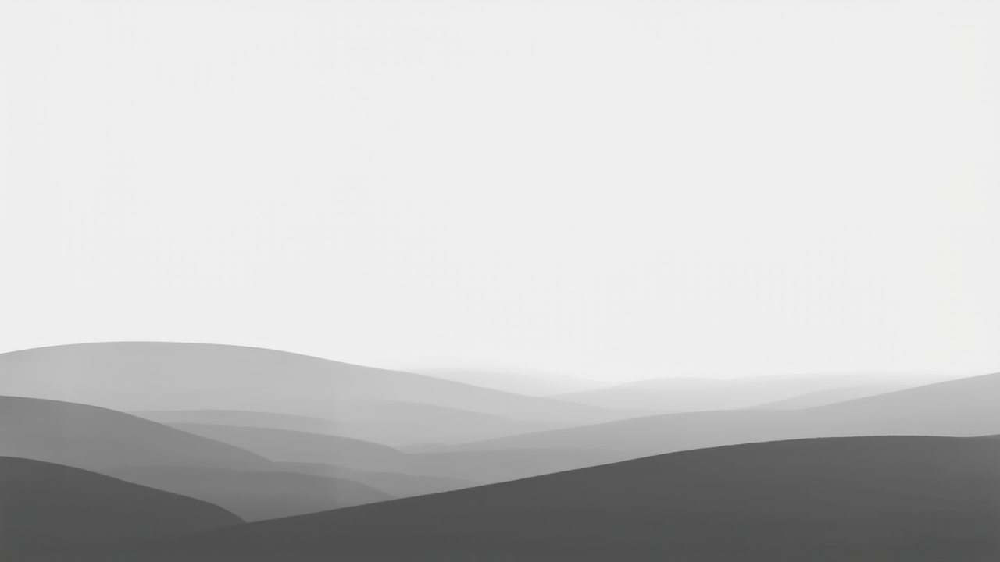

Generating image for prompt: Vector style image of a tropical range, flat design, cool colors, and a dreamy atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

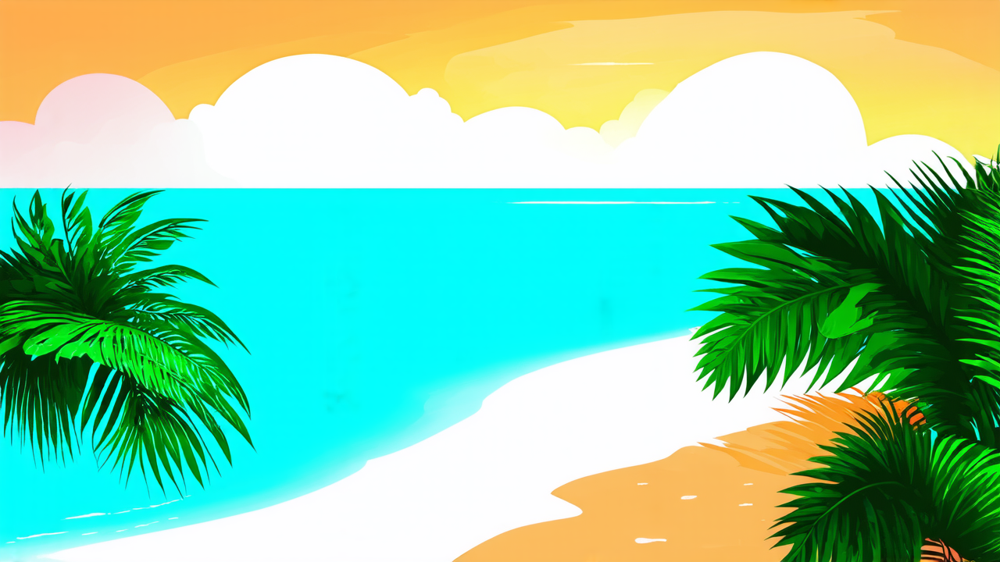

Generating image for prompt: Vector style image of a misty range, flat design, cool colors, and a whimsical atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

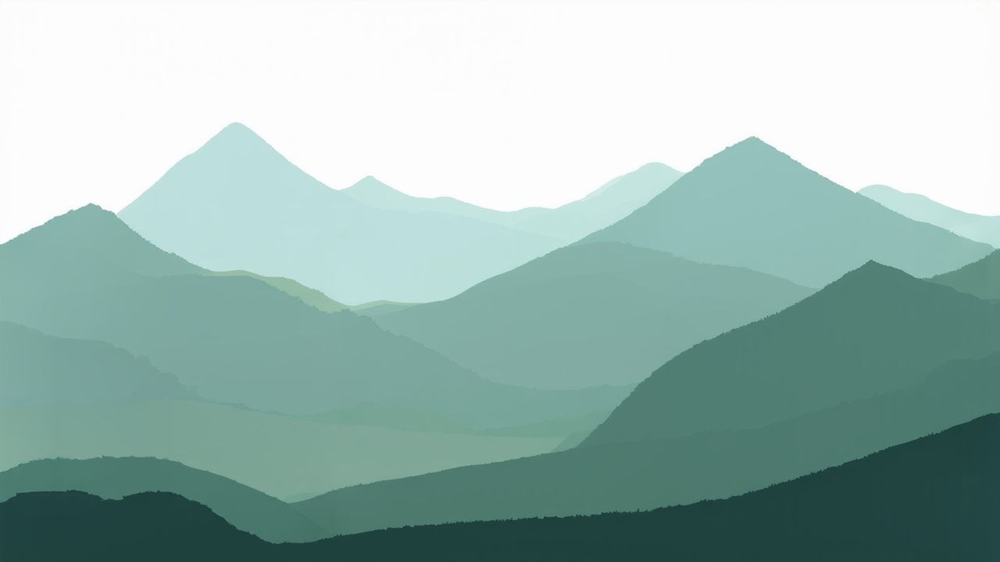

Generating image for prompt: Vector style image of a snowy range, flat design, cool colors, and a dreamy atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

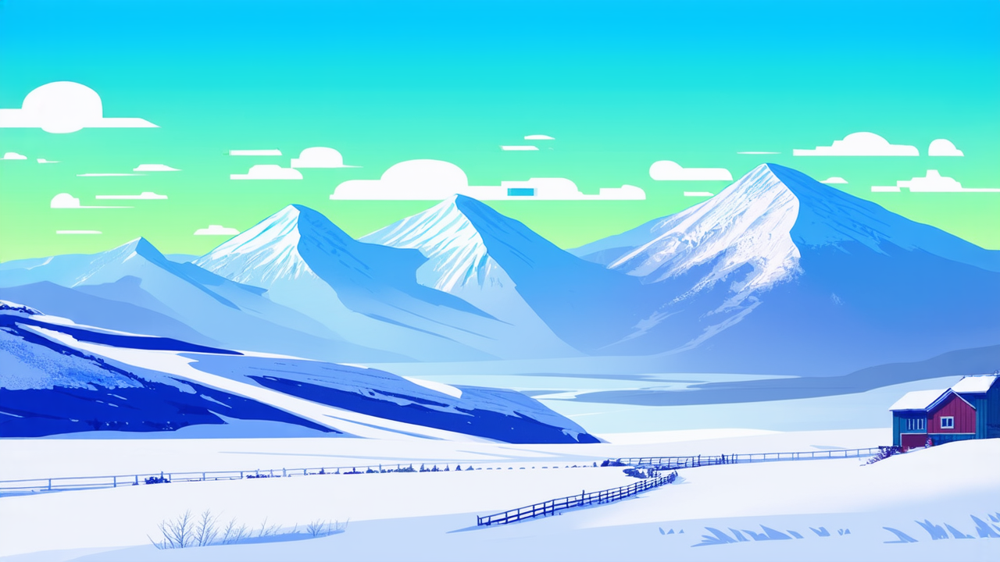

Generating image for prompt: montain landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

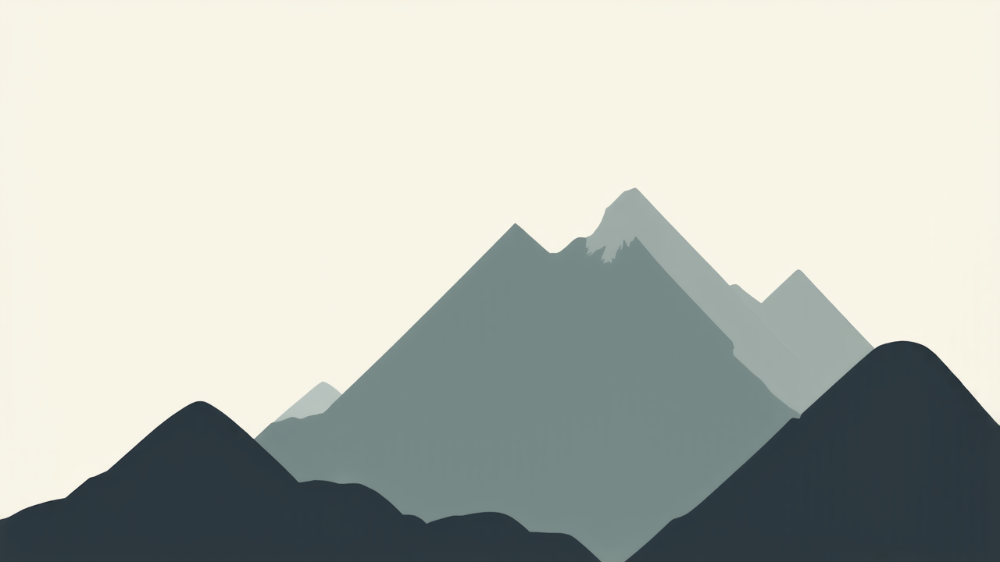

Generating image for prompt: Vector style image of a montain range, flat design, cool colors, and a whimsical atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

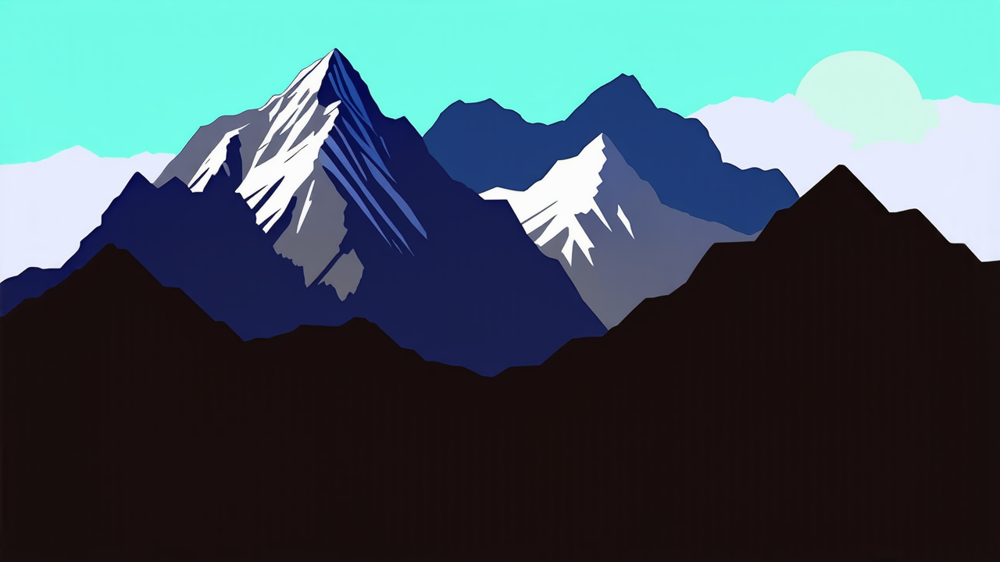

Generating image for prompt: Vector style image of a beachy range, flat design, cool colors, and a dramatic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

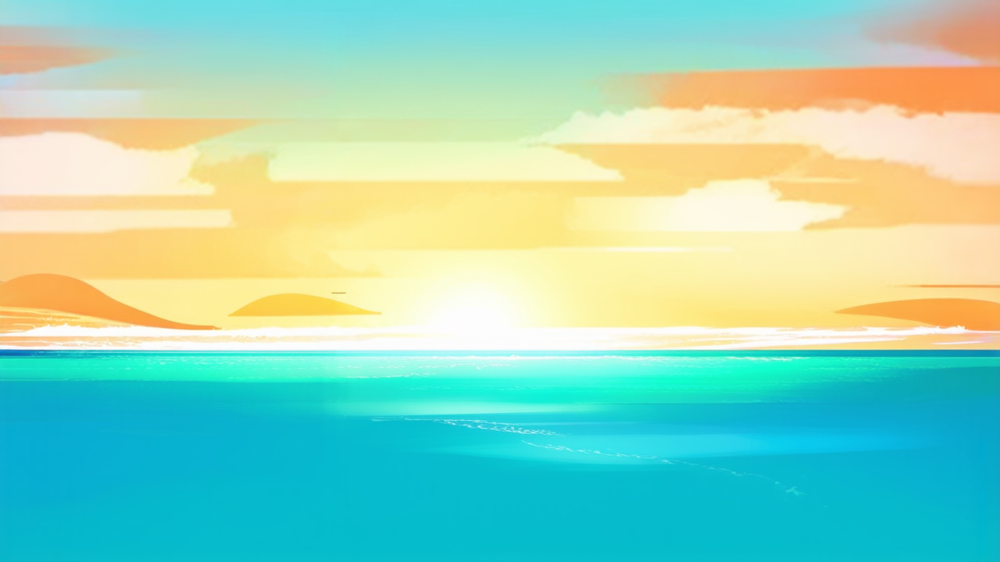

Generating image for prompt: beachy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

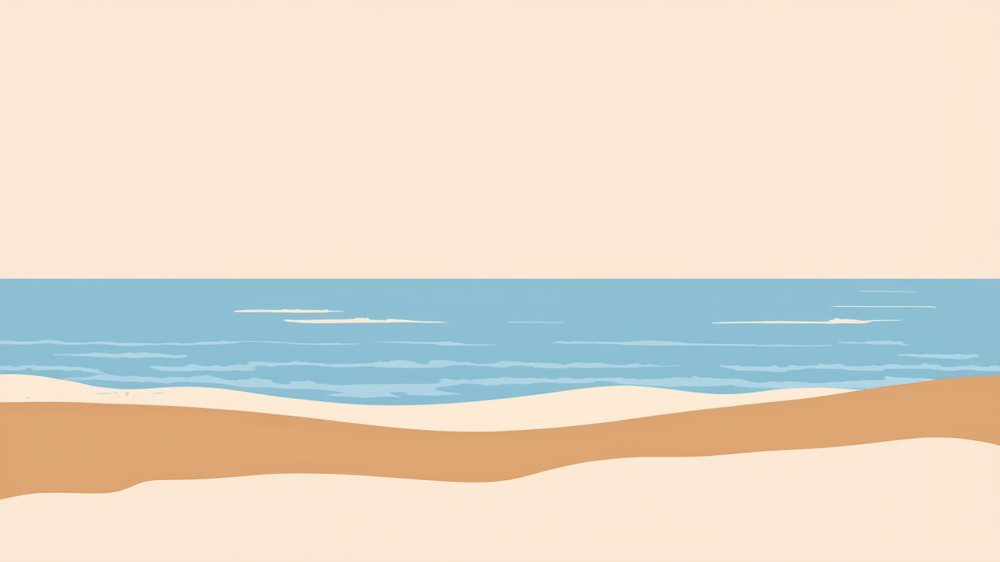

Generating image for prompt: Vector style landscape of a whimsical misty, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

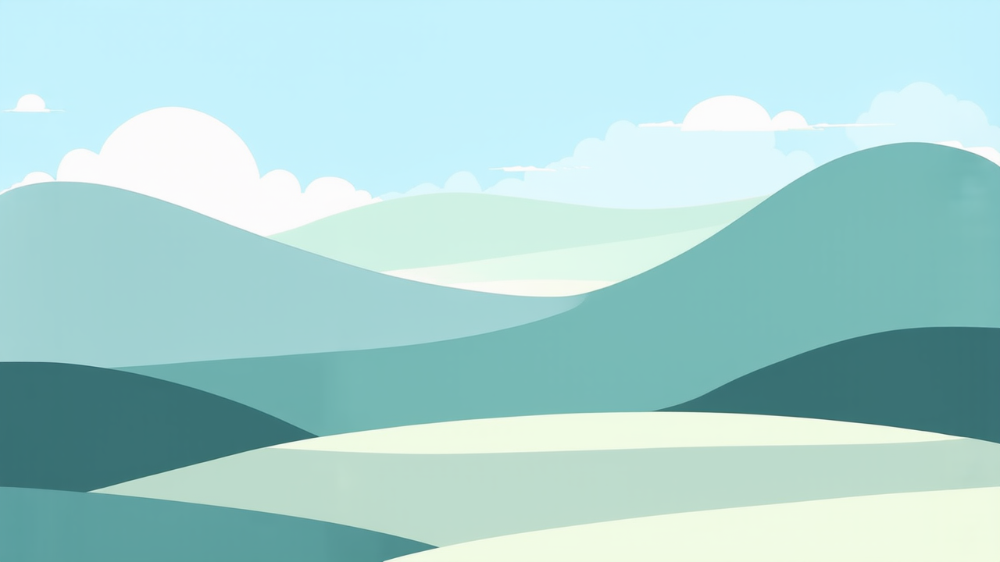

Generating image for prompt: misty landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

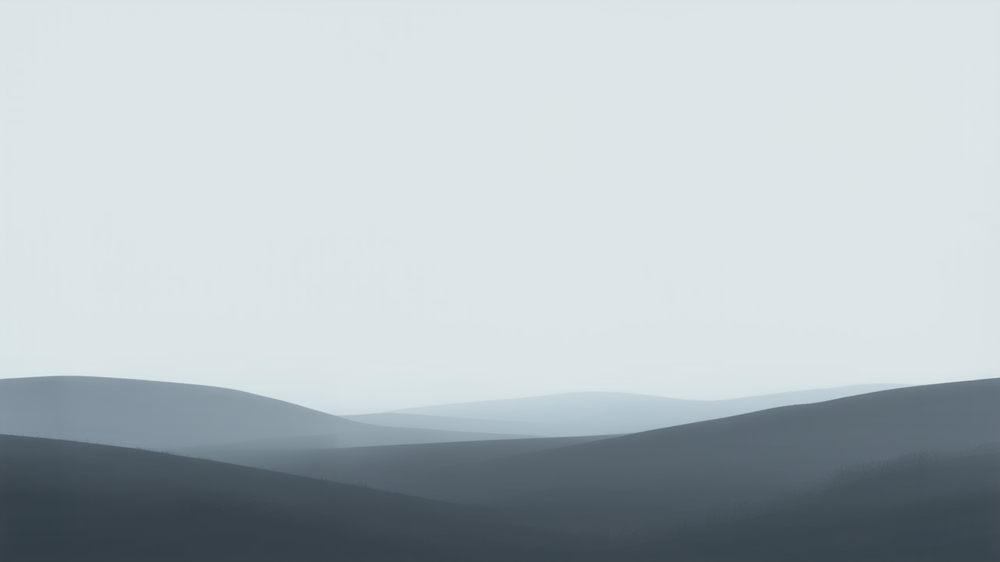

Generating image for prompt: Vector style image of a arctic range, flat design, cool colors, and a whimsical atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

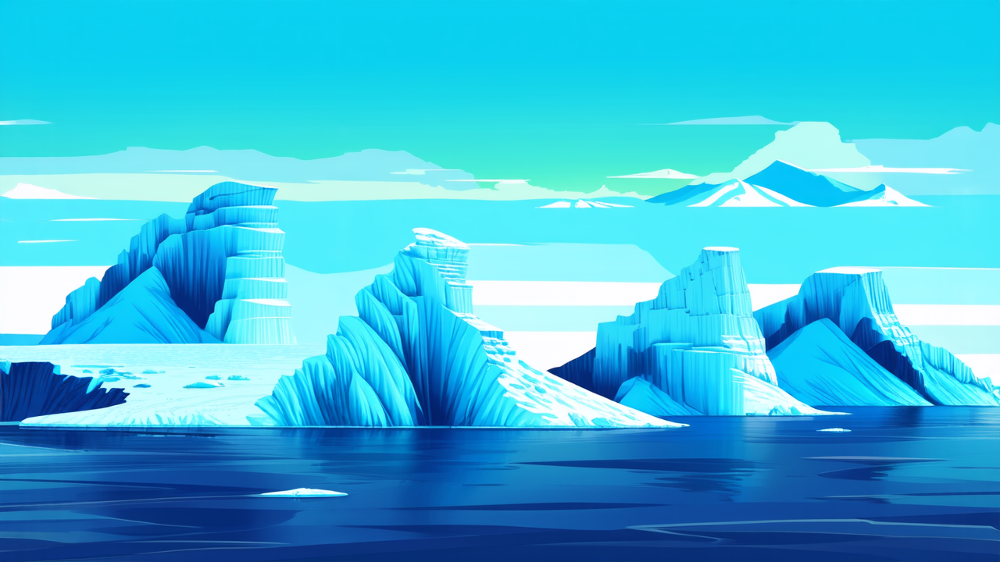

Generating image for prompt: snowy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

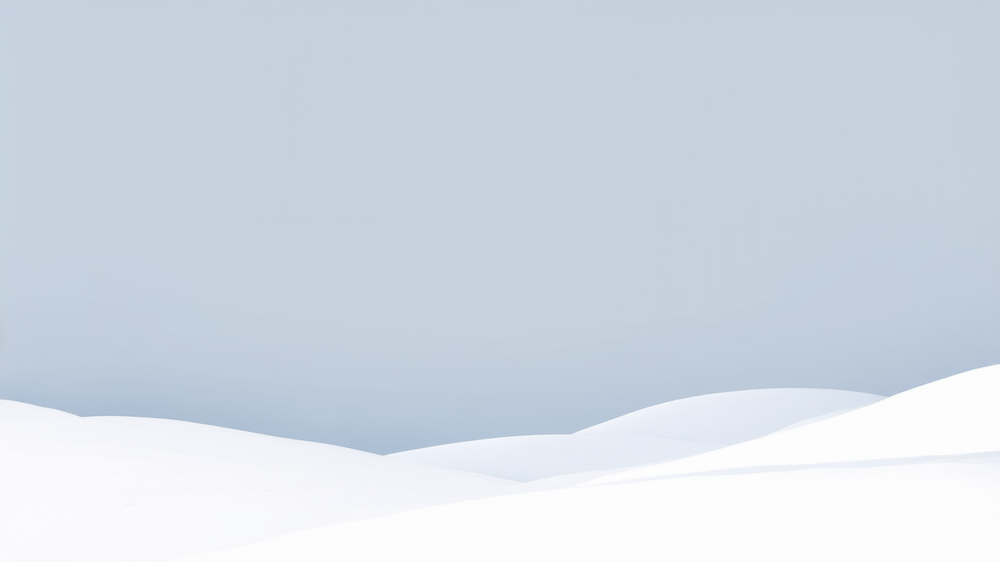

Generating image for prompt: Vector style landscape of a energetic volcanic, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

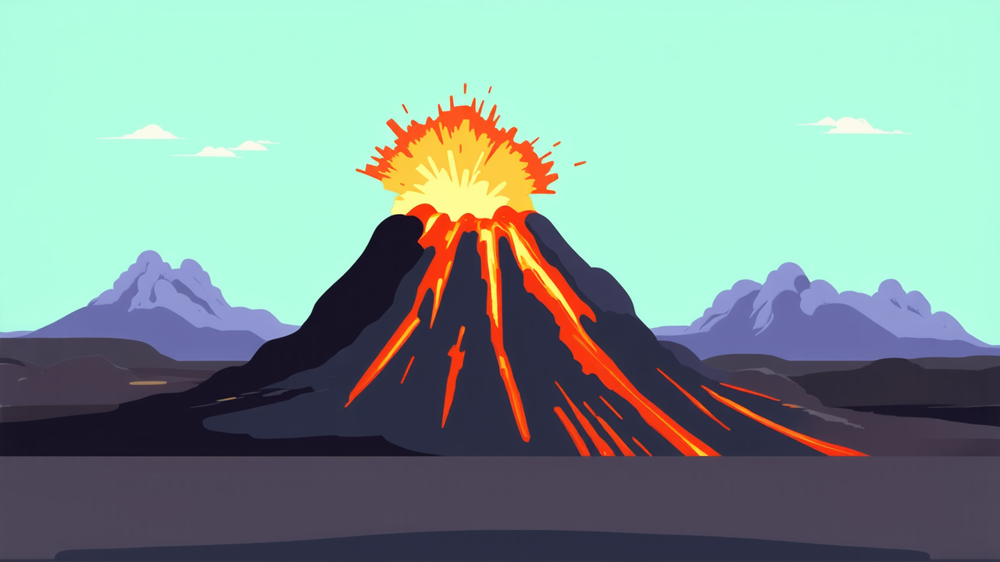

Generating image for prompt: desert landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

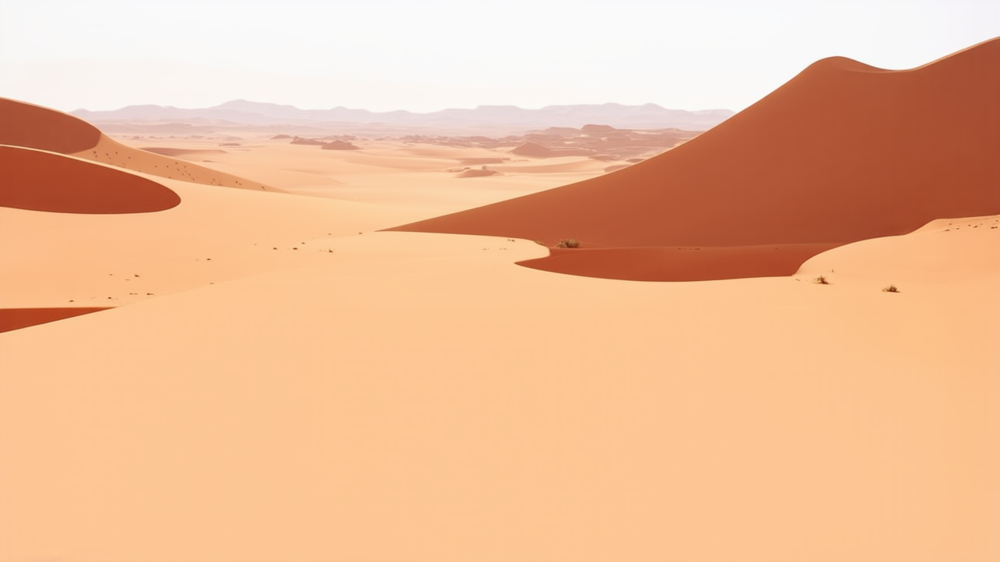

Generating image for prompt: foggy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

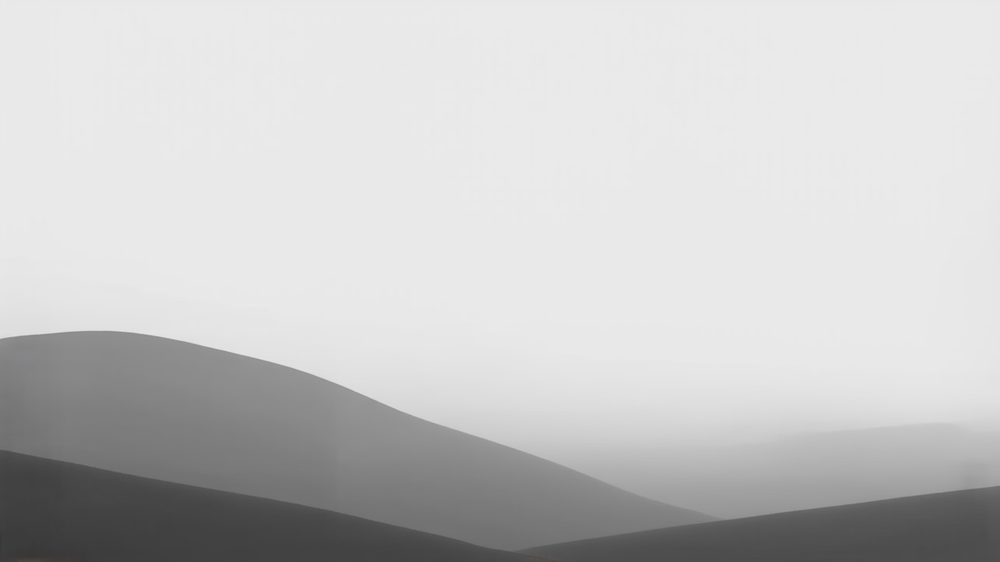

Generating image for prompt: Vector style landscape of a mysterious tropical, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

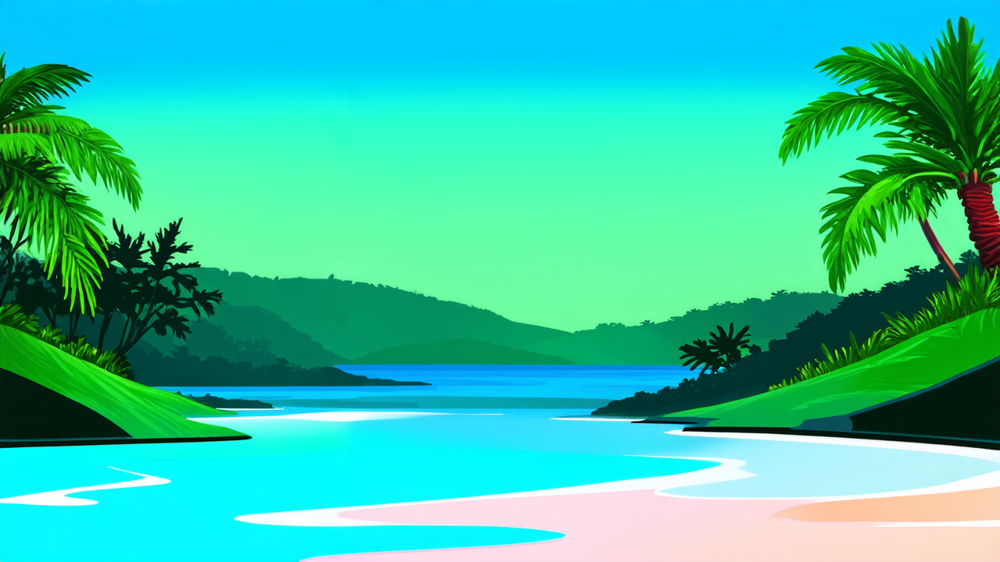

Generating image for prompt: foggy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

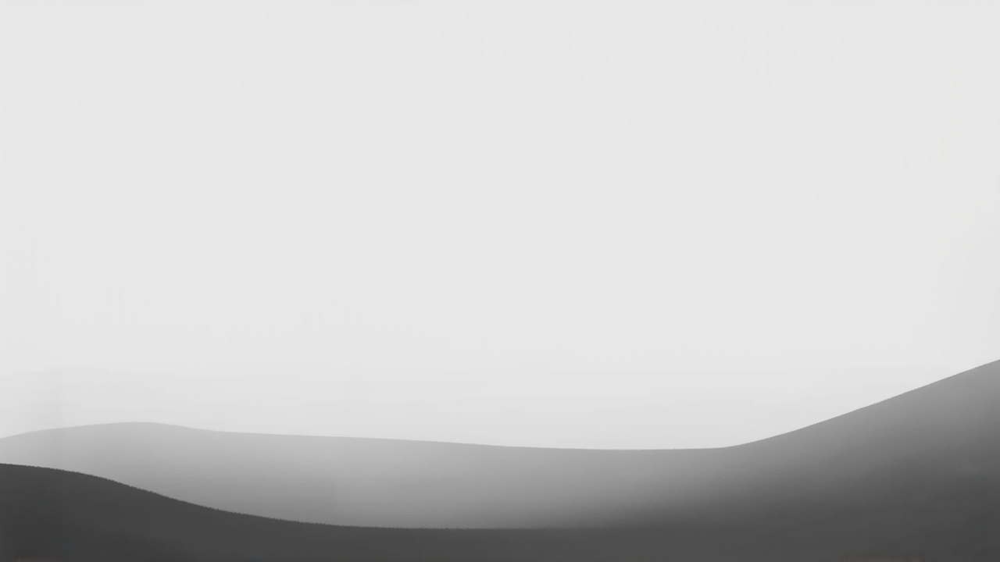

Generating image for prompt: snowy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

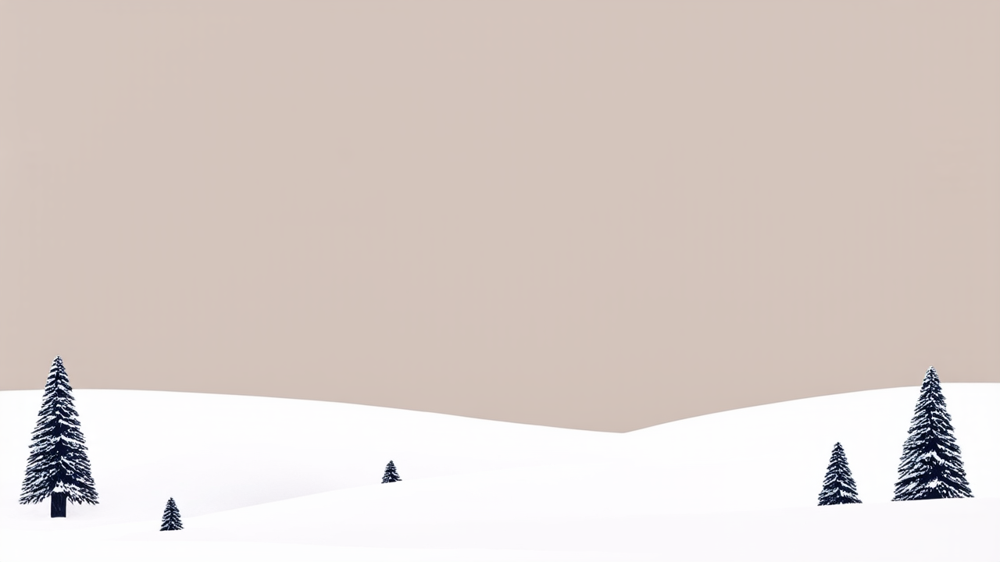

Generating image for prompt: desert landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

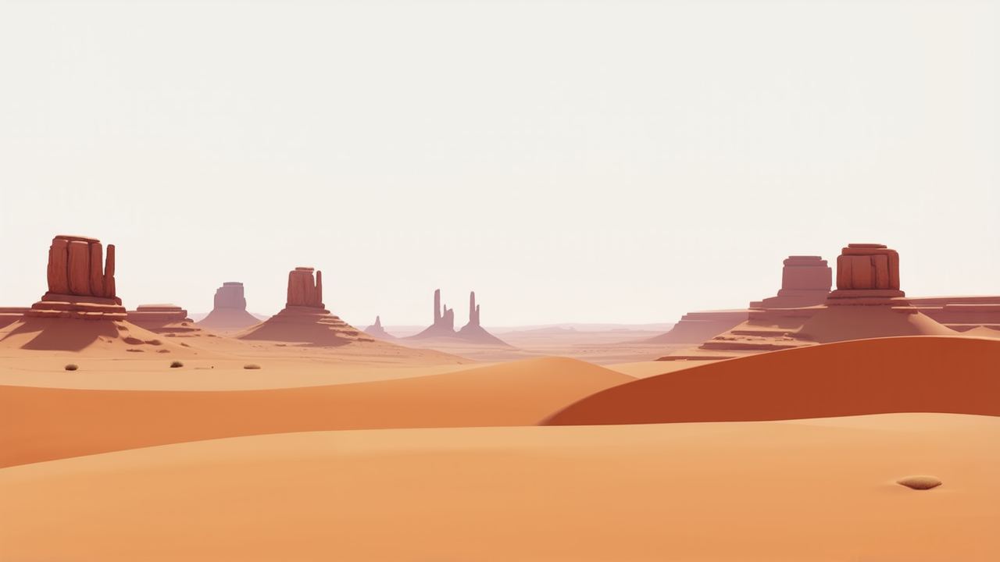

Generating image for prompt: Vector style image of a volcanic range, flat design, cool colors, and a dramatic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

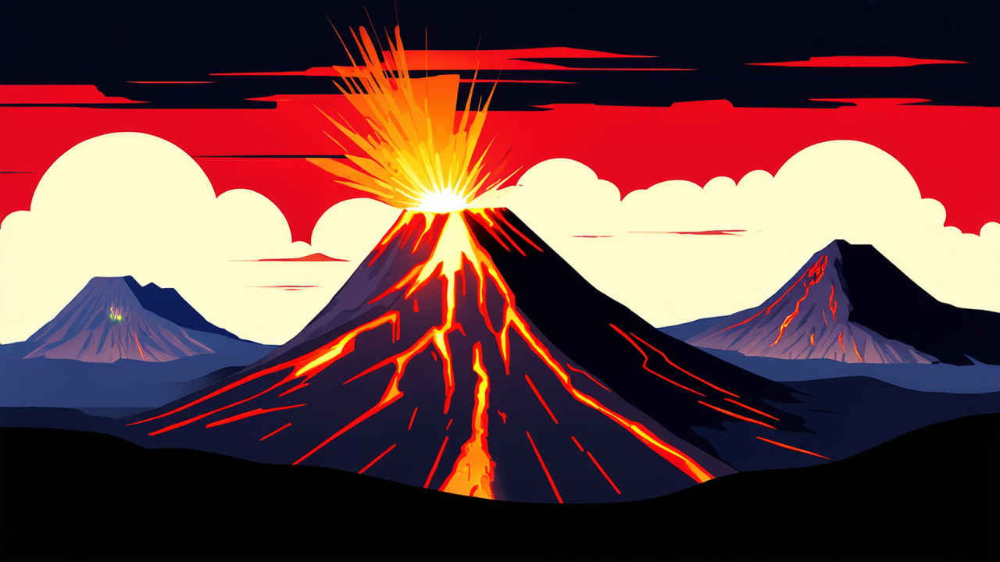

Generating image for prompt: Vector style image of a misty range, flat design, cool colors, and a dramatic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

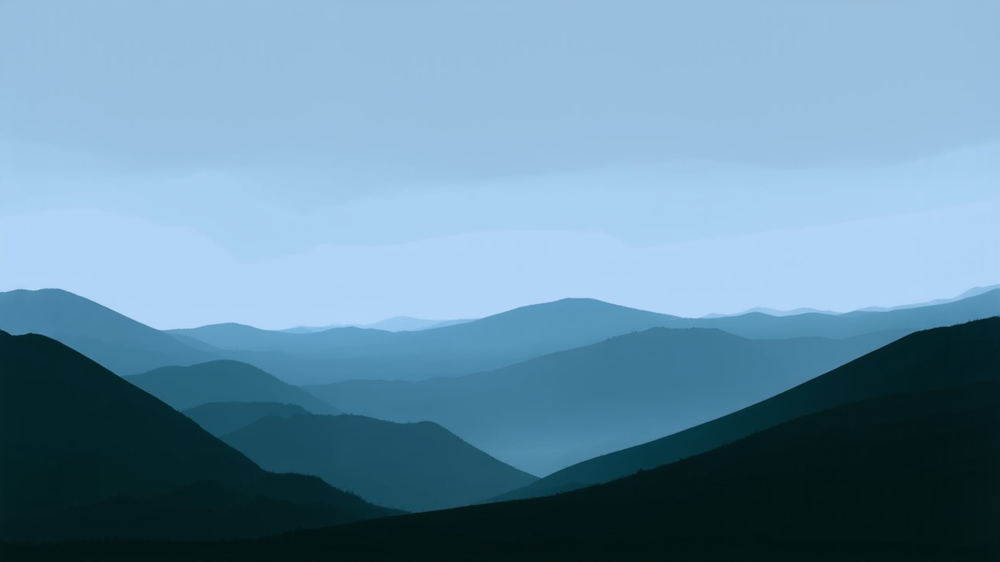

Generating image for prompt: misty landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

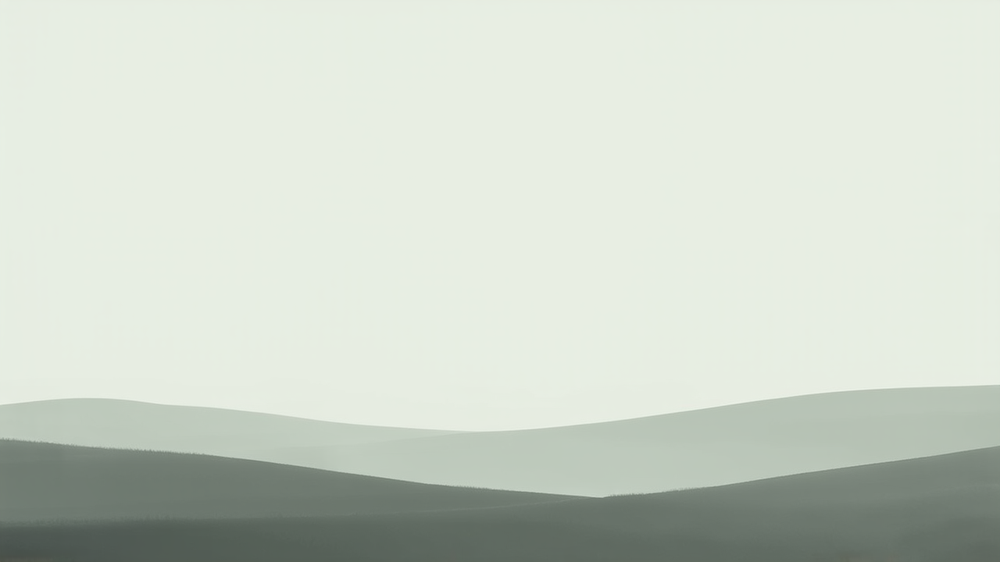

Generating image for prompt: Vector style landscape of a dramatic beachy, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

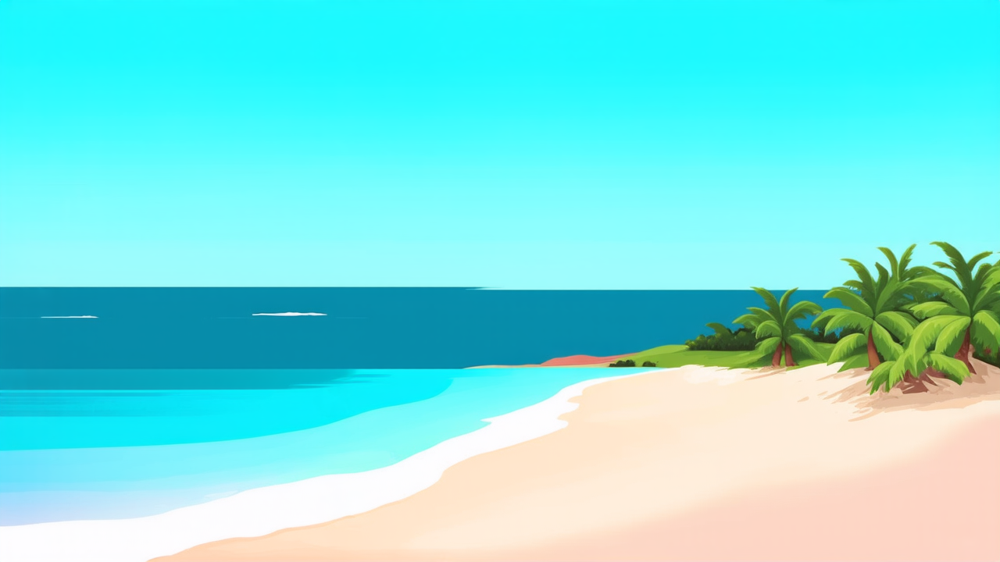

Generating image for prompt: Vector style image of a tropical range, flat design, cool colors, and a energetic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

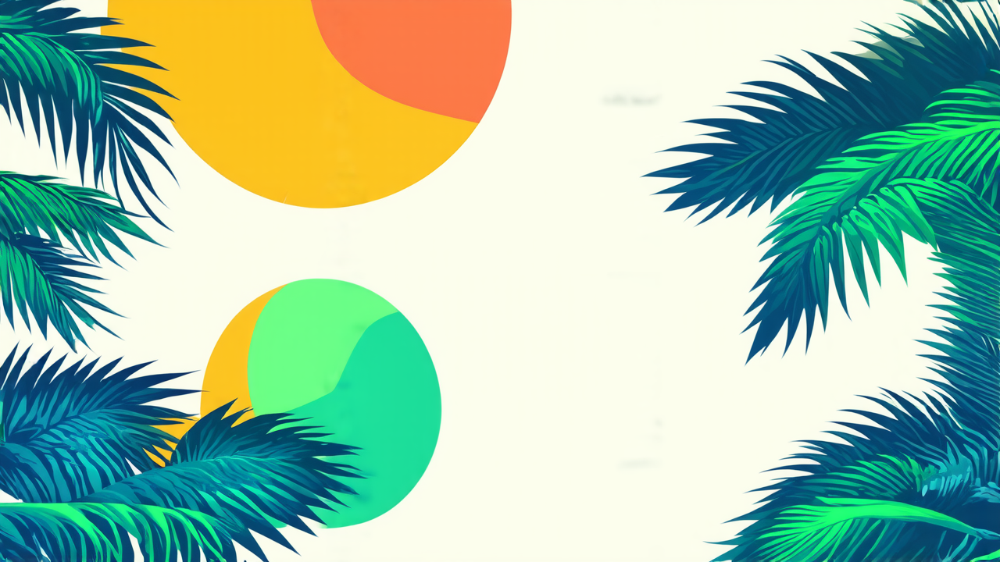

Generating image for prompt: Vector style landscape of a dramatic arctic, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

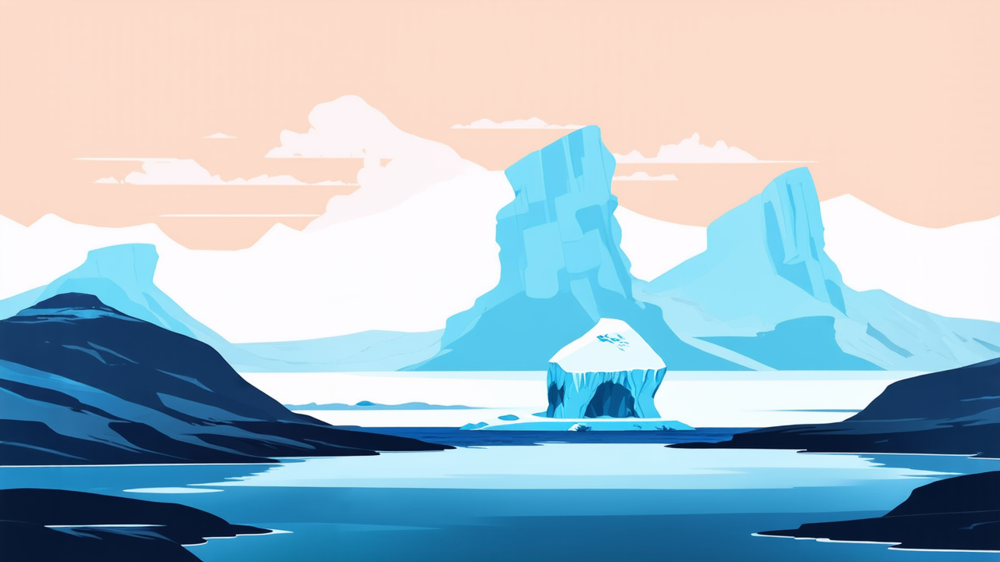

Generating image for prompt: montain landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

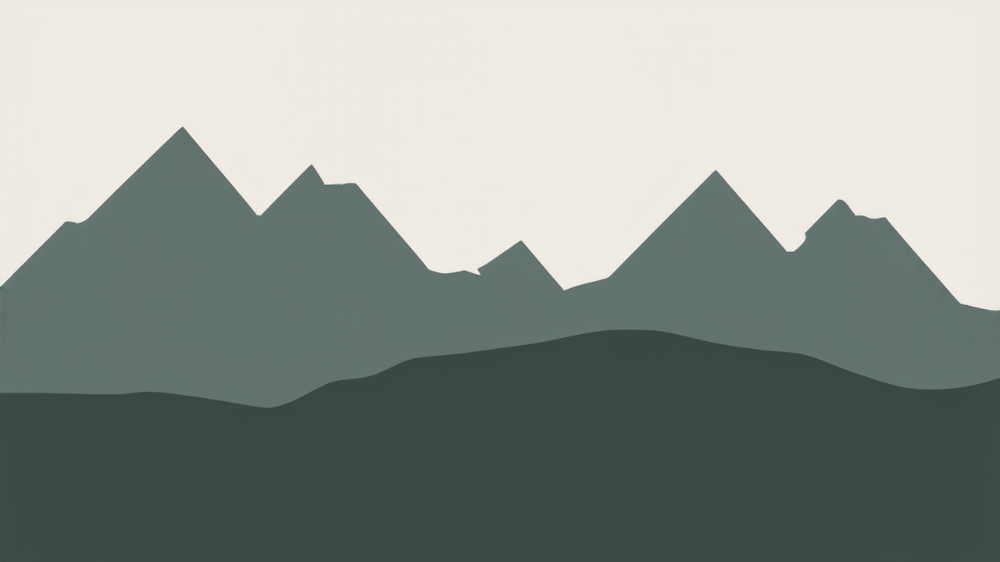

Generating image for prompt: foggy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

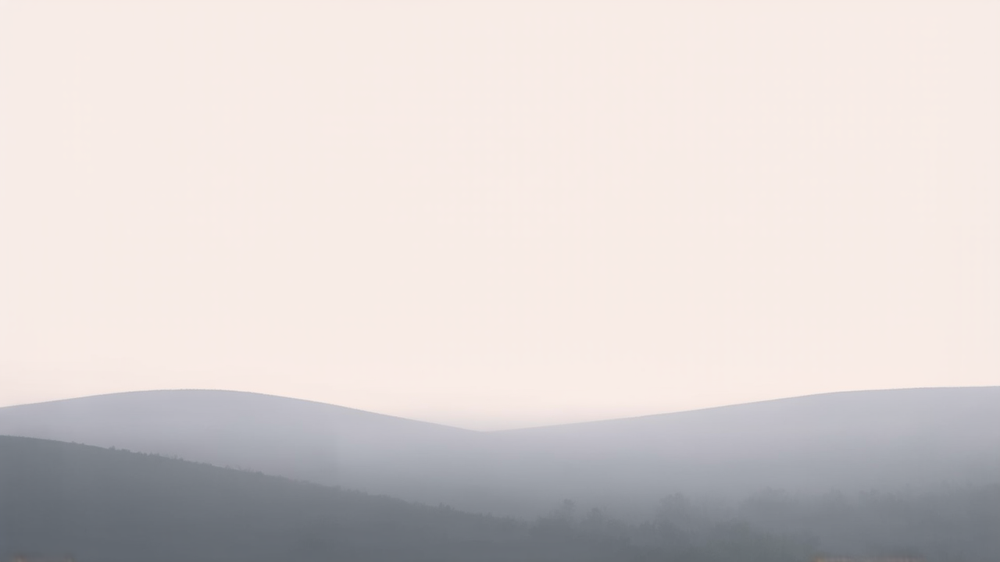

Generating image for prompt: arctic landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

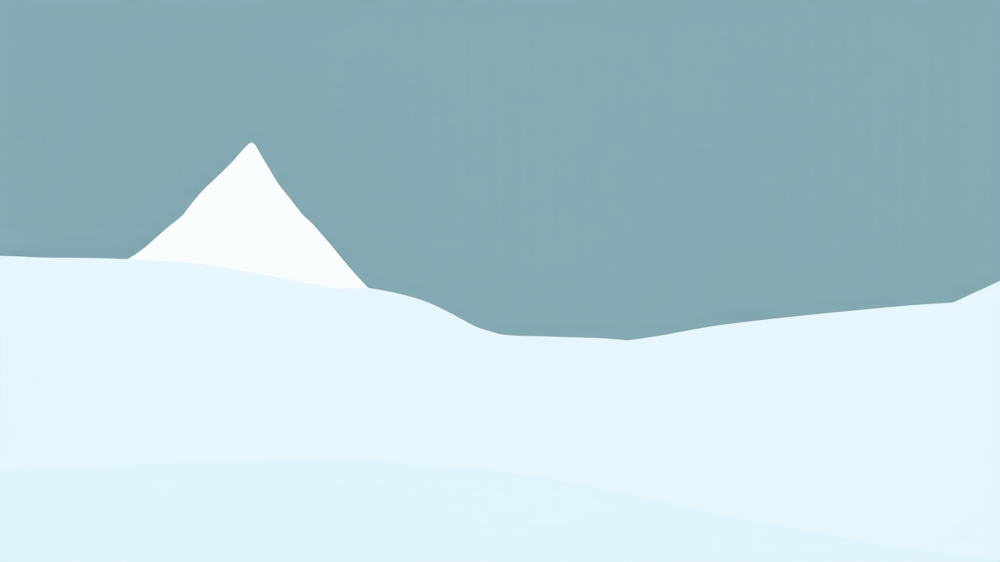

Generating image for prompt: foggy landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

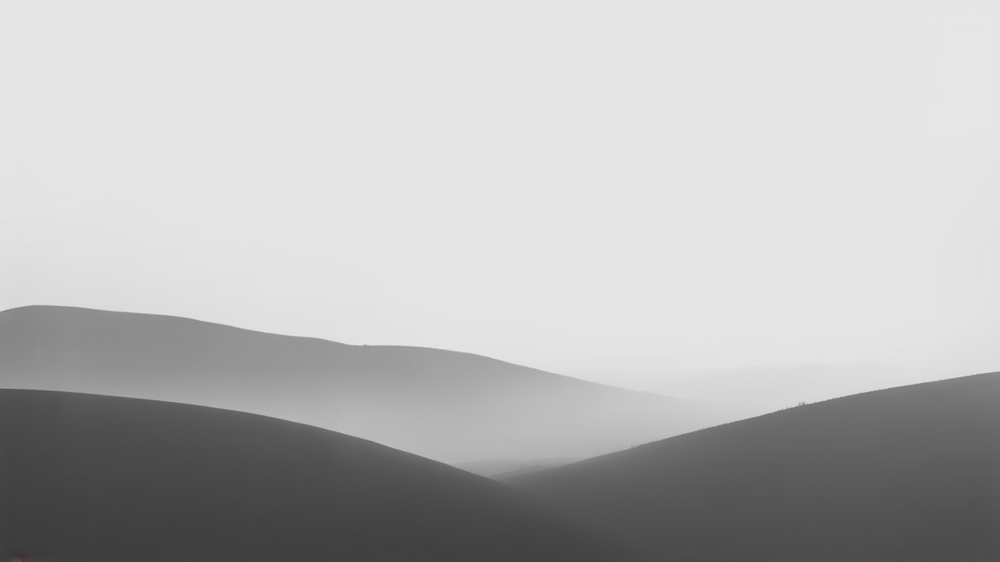

Generating image for prompt: Vector style image of a tropical range, flat design, cool colors, and a serene atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

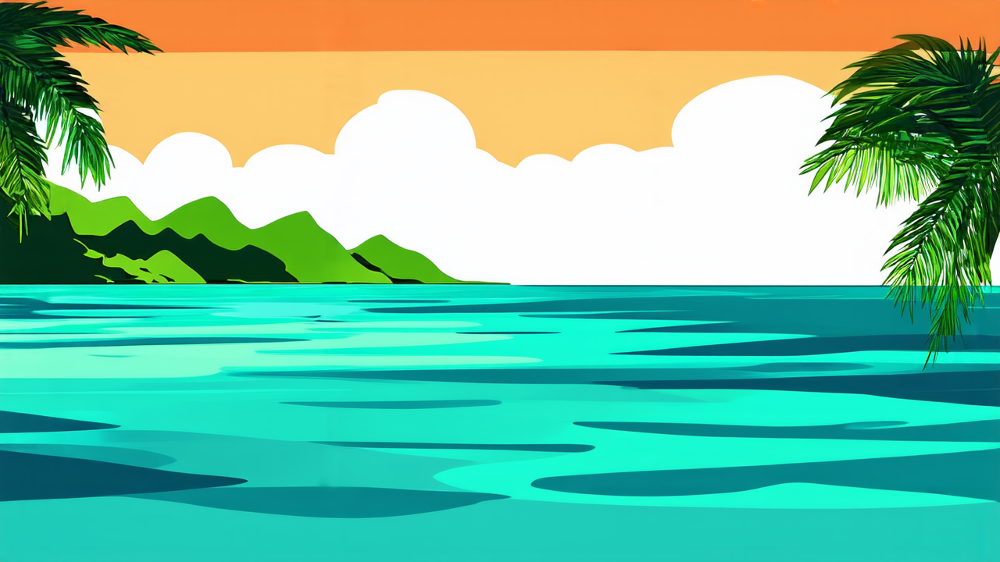

Generating image for prompt: Vector style image of a montain range, flat design, cool colors, and a calm atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

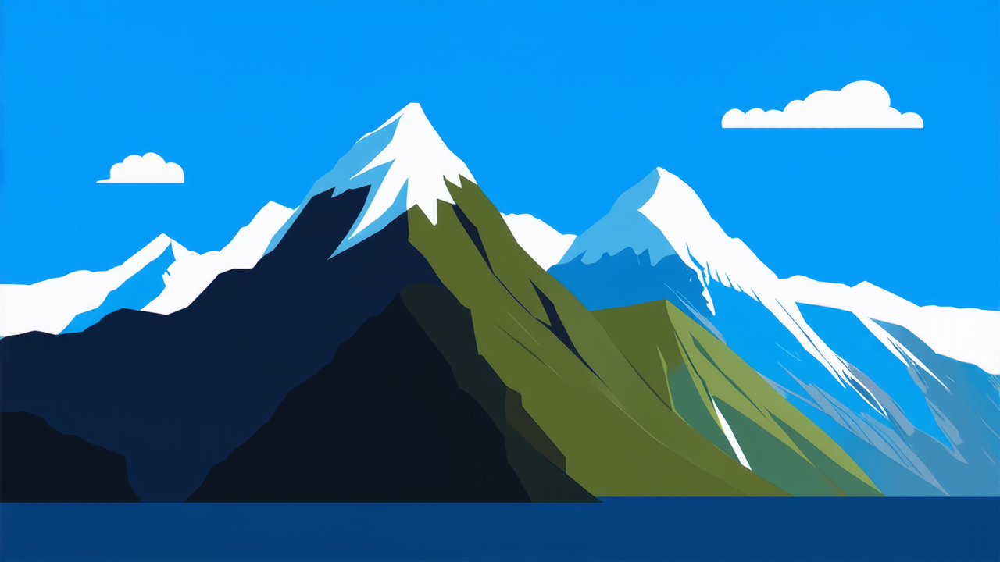

Generating image for prompt: Vector style image of a montain range, flat design, cool colors, and a dramatic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

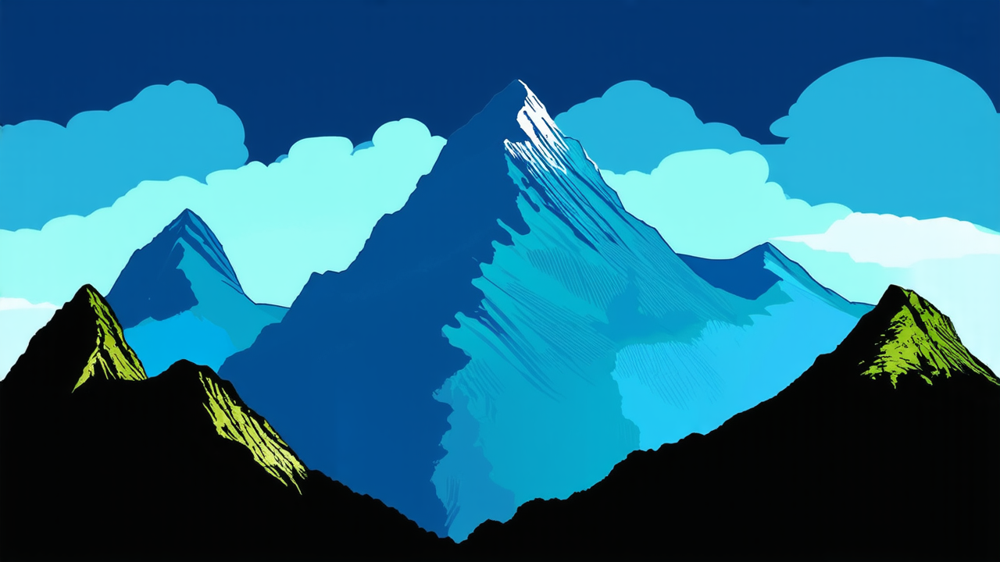

Generating image for prompt: Vector style landscape of a serene montain, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

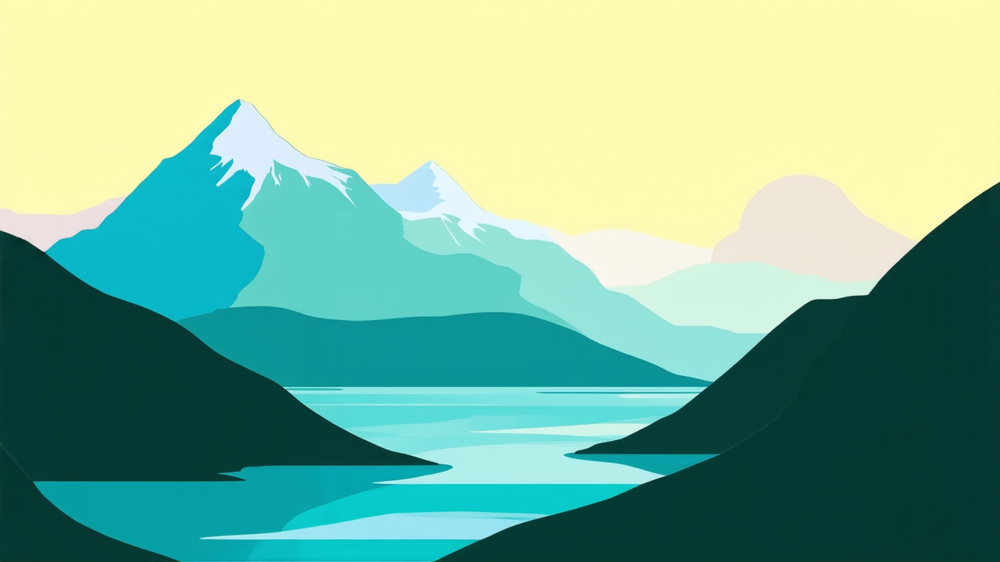

Generating image for prompt: Vector style landscape of a vibrant forest, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

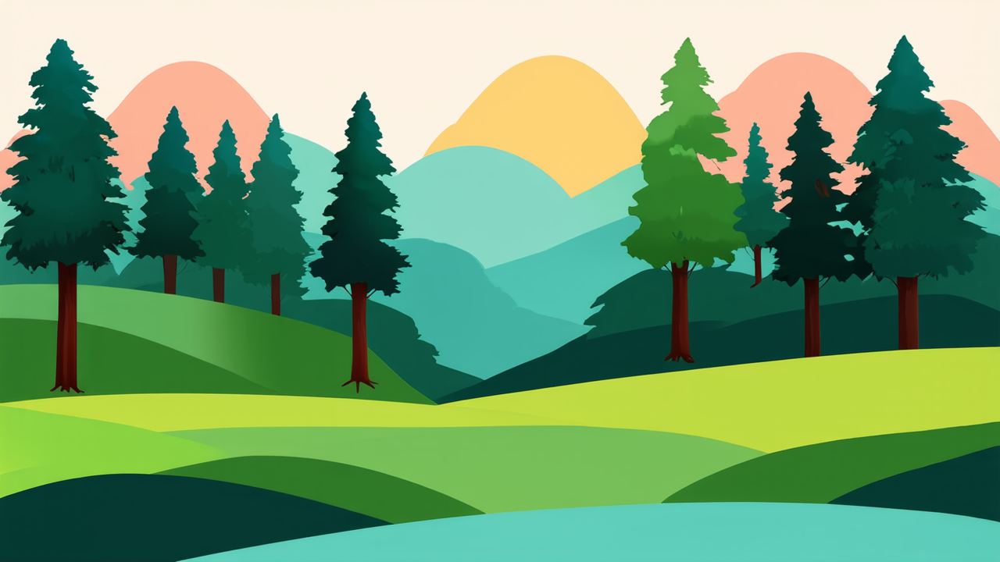

Generating image for prompt: Vector style landscape of a moody montain, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

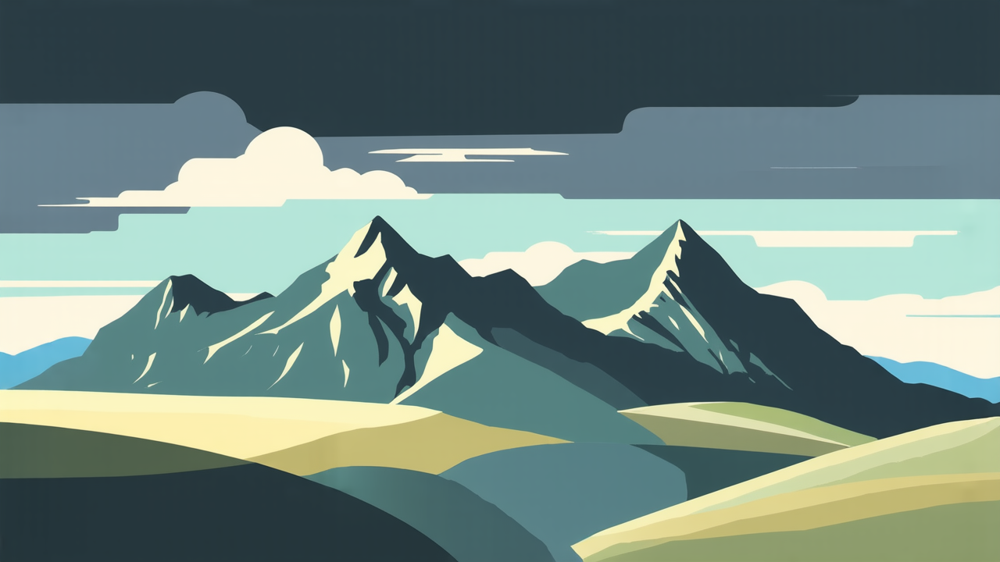

Generating image for prompt: Vector style image of a montain range, flat design, cool colors, and a dramatic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

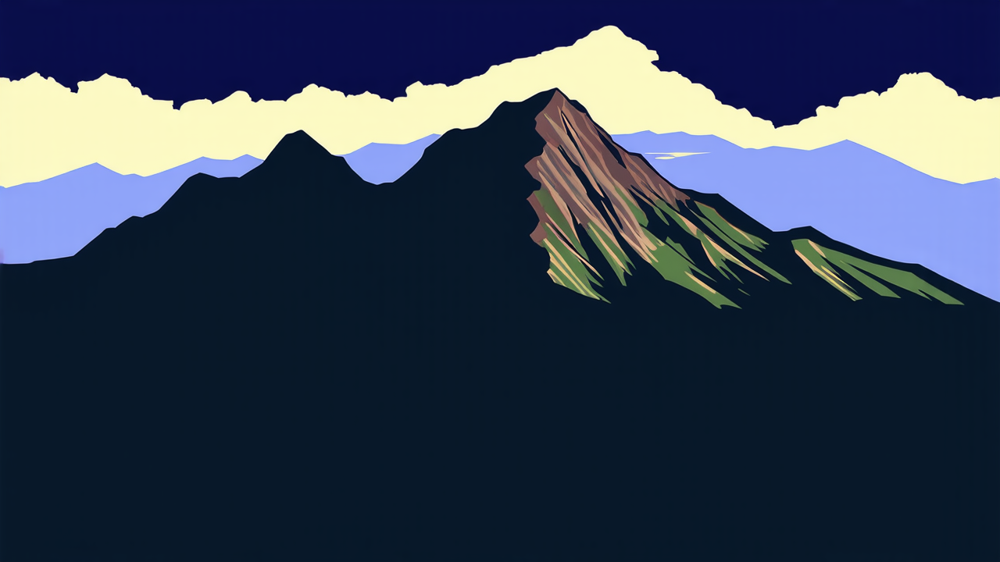

Generating image for prompt: Vector style image of a beachy range, flat design, cool colors, and a whimsical atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

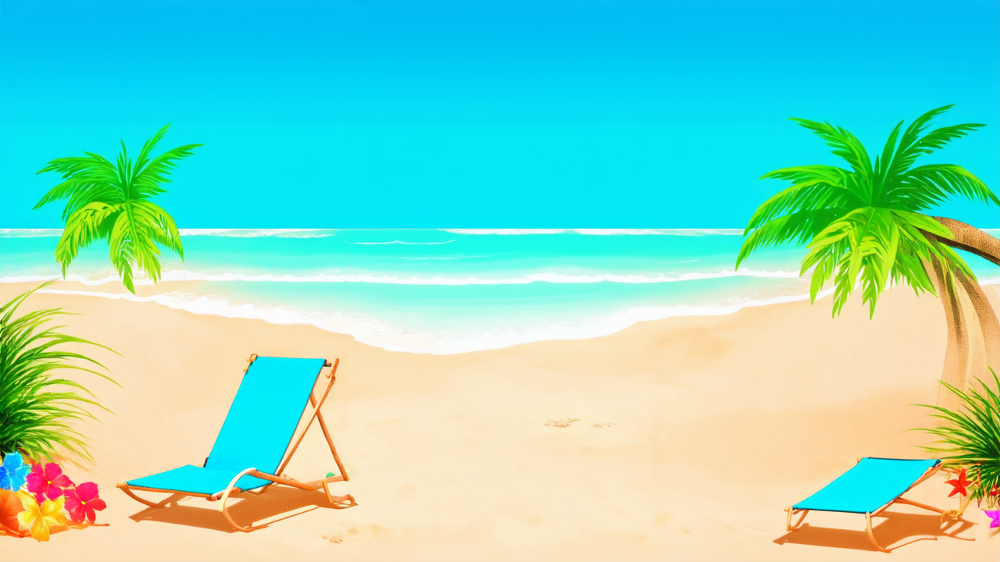

Generating image for prompt: Vector style landscape of a melancholic volcanic, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

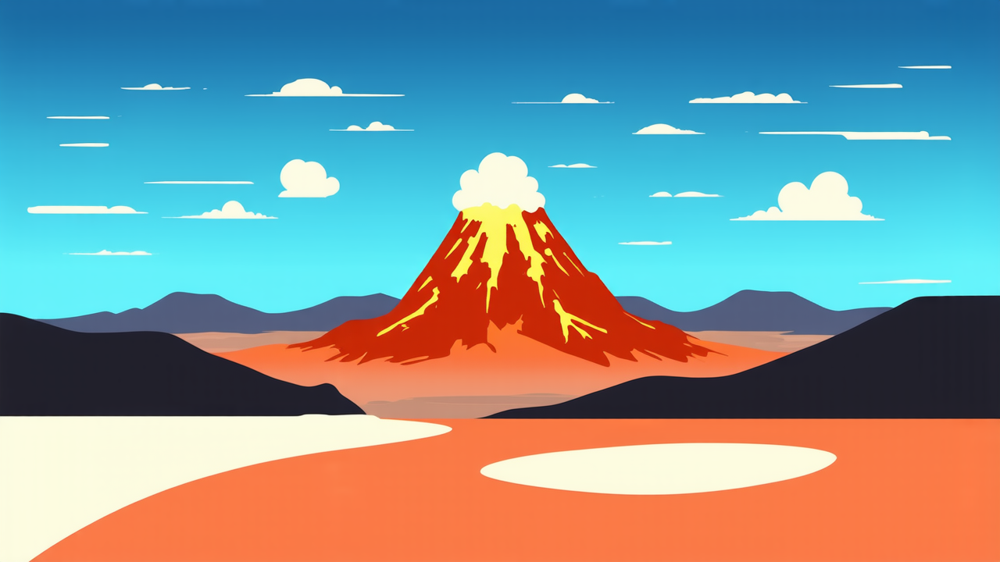

Generating image for prompt: Vector style image of a snowy range, flat design, cool colors, and a vibrant atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

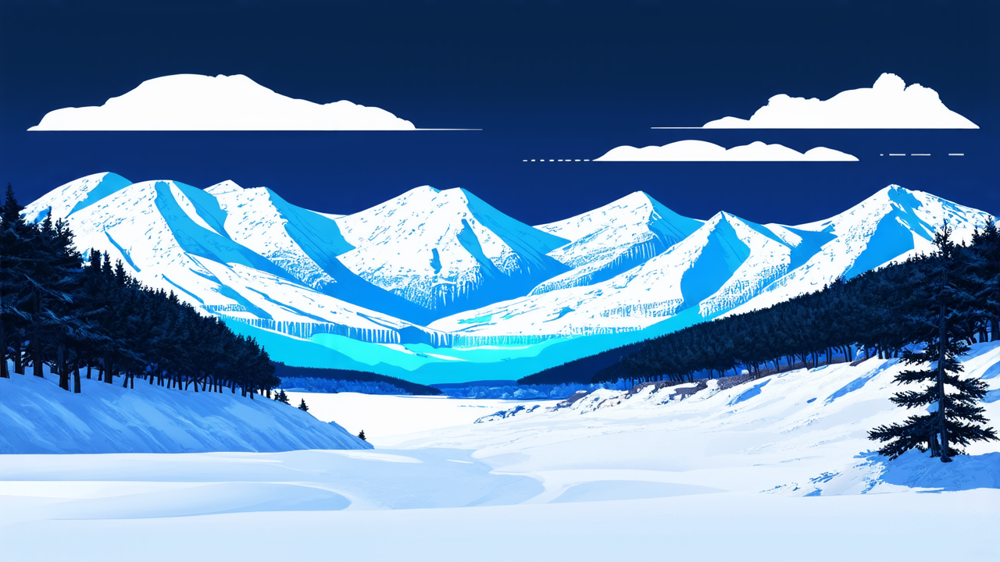

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a melancholic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

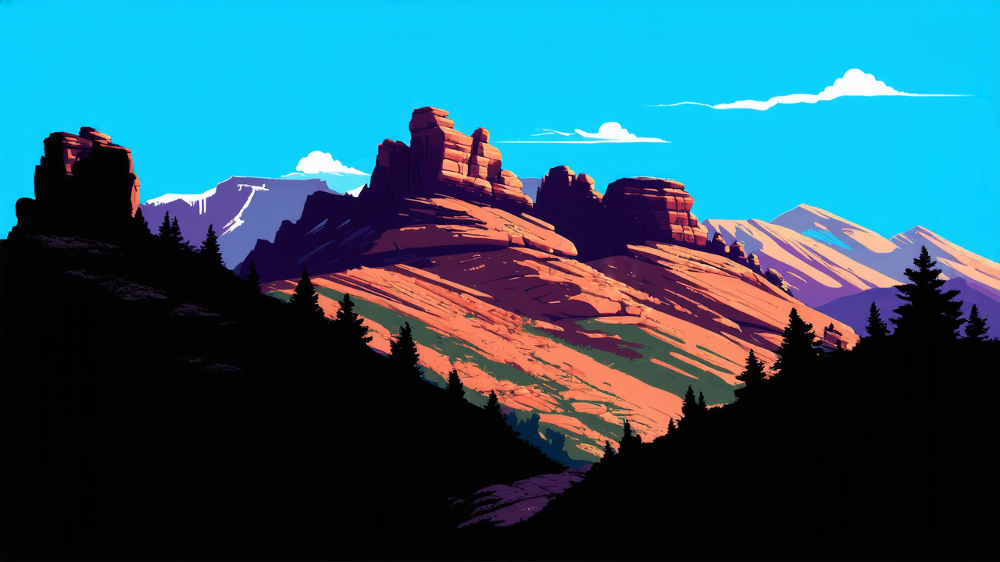

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a adventurous atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

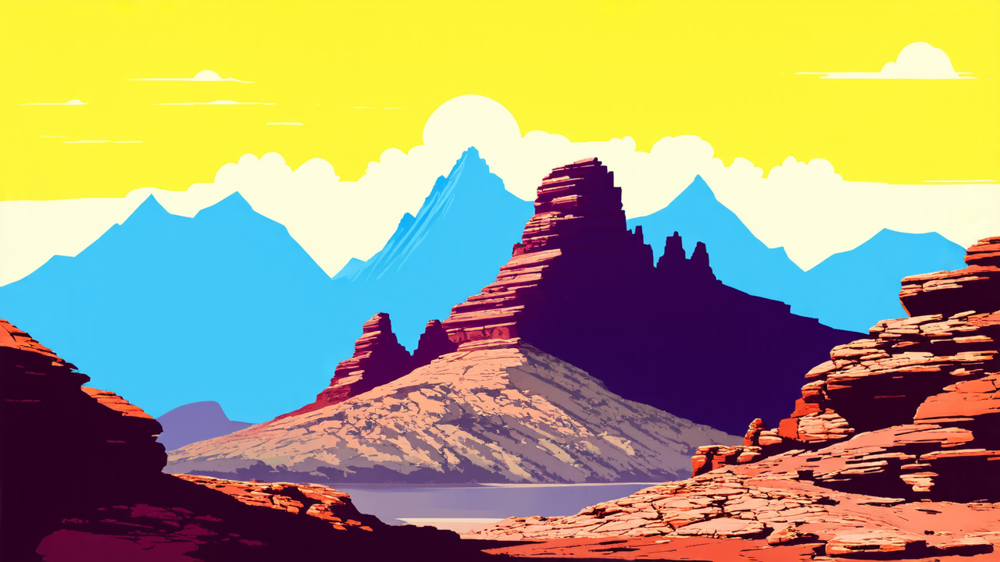

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a serene atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

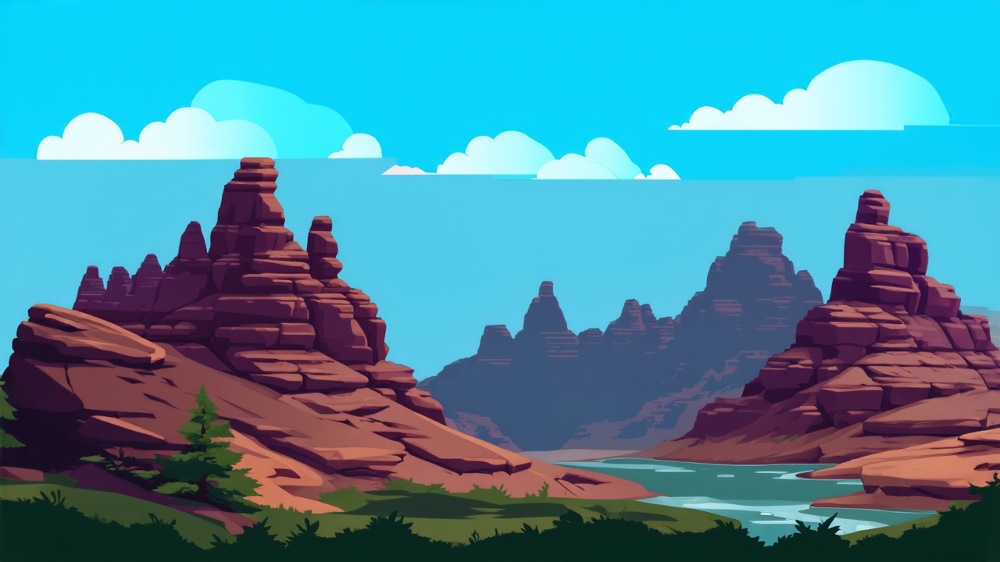

Generating image for prompt: tropical landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

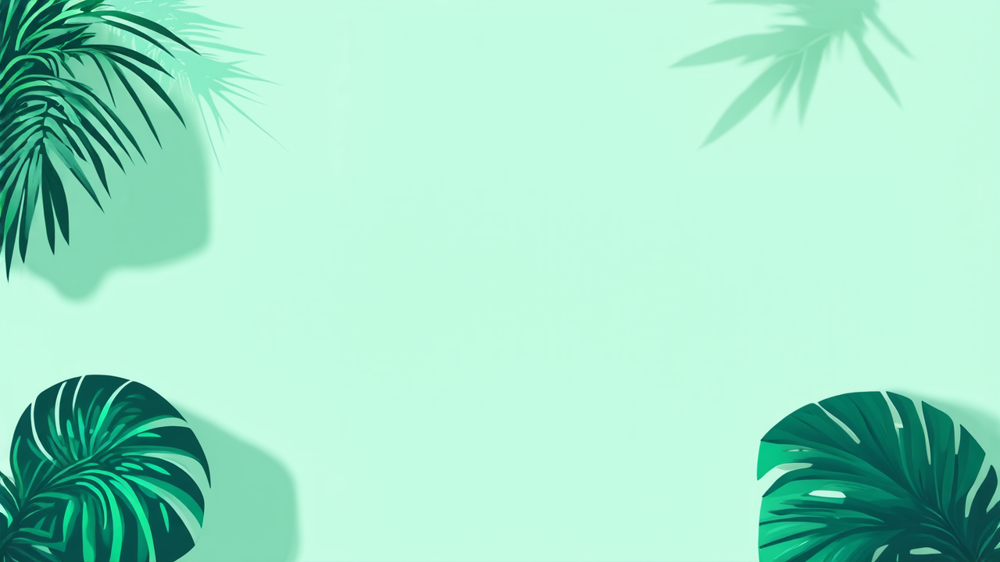

Generating image for prompt: Vector style image of a forest range, flat design, cool colors, and a adventurous atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

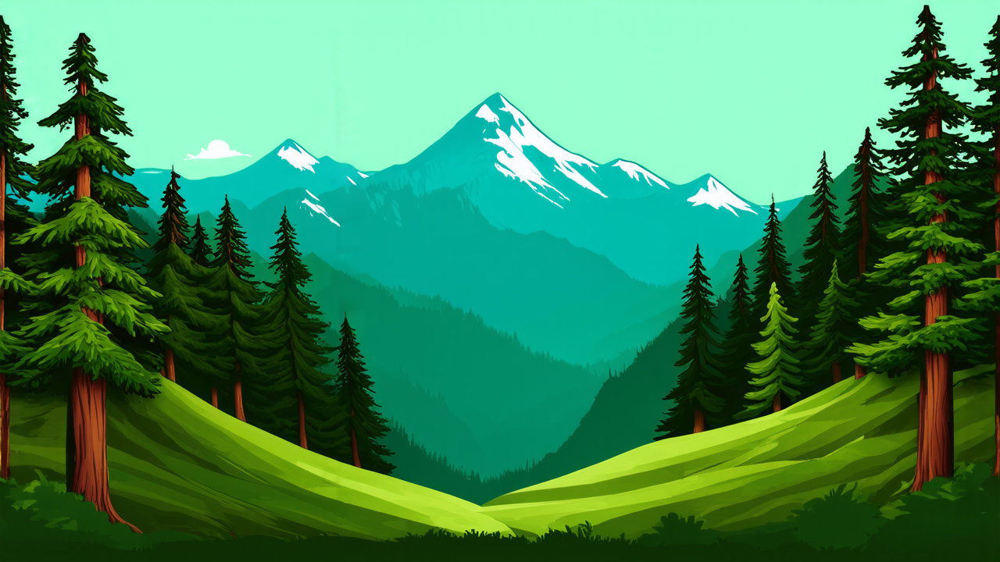

Generating image for prompt: misty landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

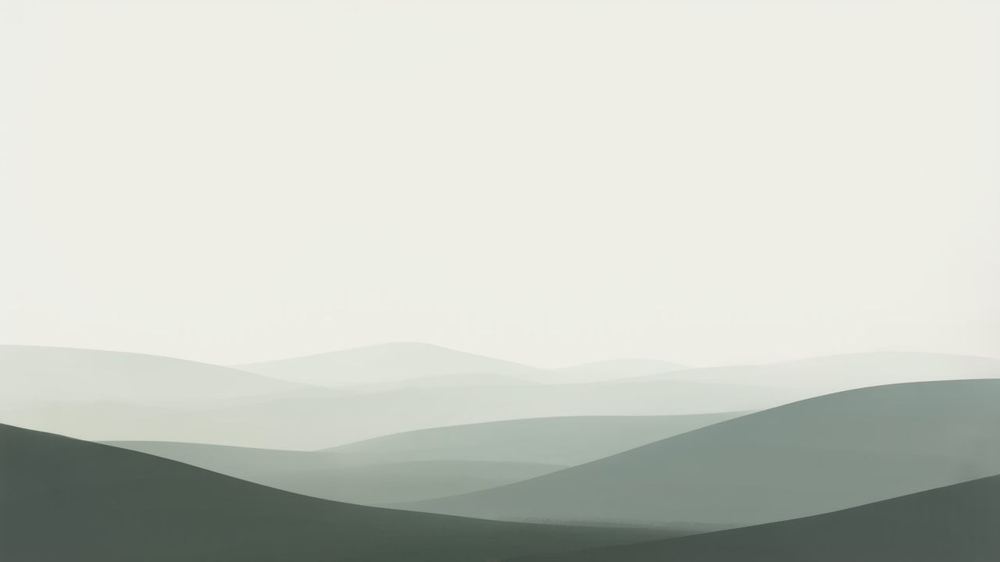

Generating image for prompt: Vector style image of a forest range, flat design, cool colors, and a serene atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

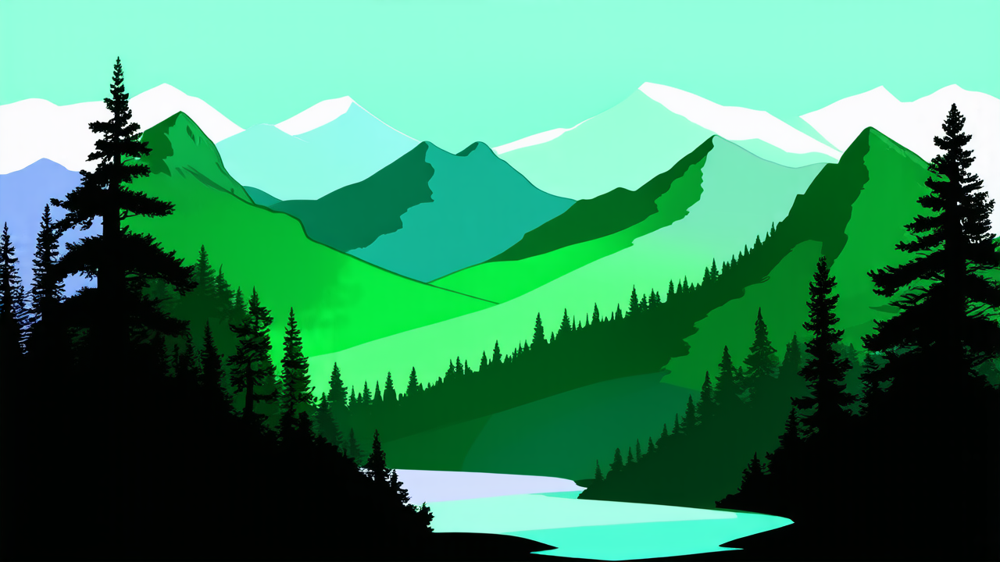

Generating image for prompt: desert landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

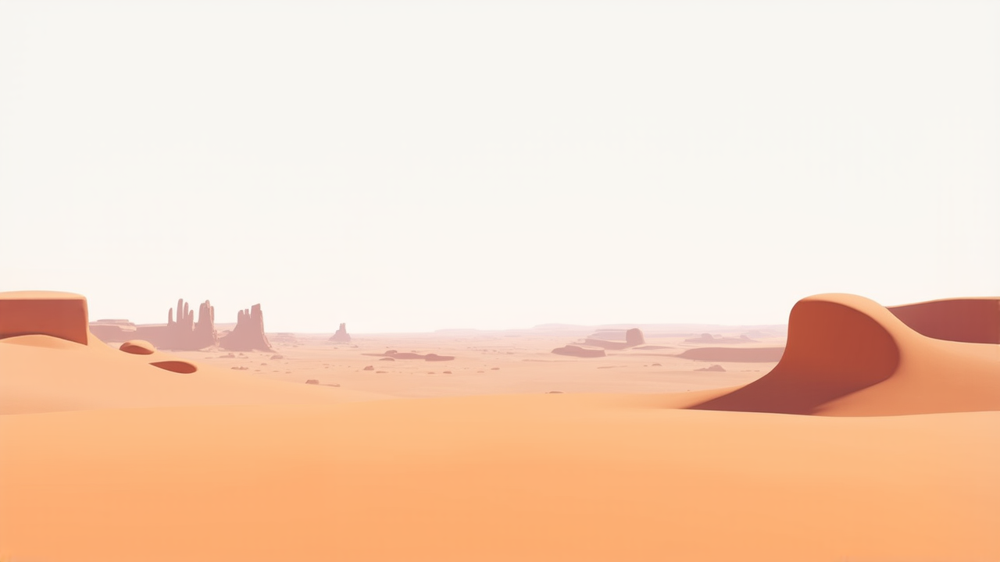

Generating image for prompt: forest landscape background in minimalist style, with simple shapes and muted tones.


  0%|          | 0/50 [00:00<?, ?it/s]

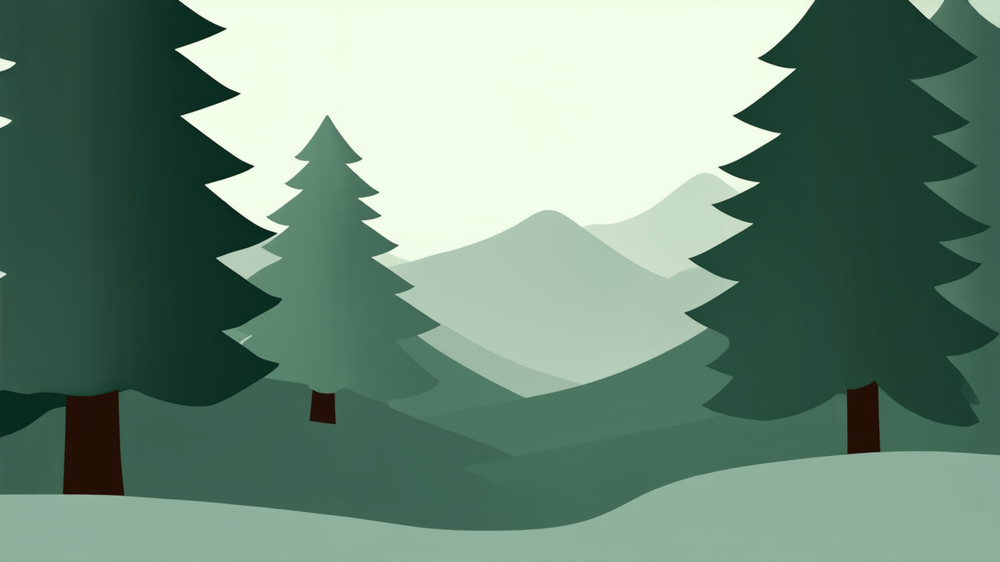

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a adventurous atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

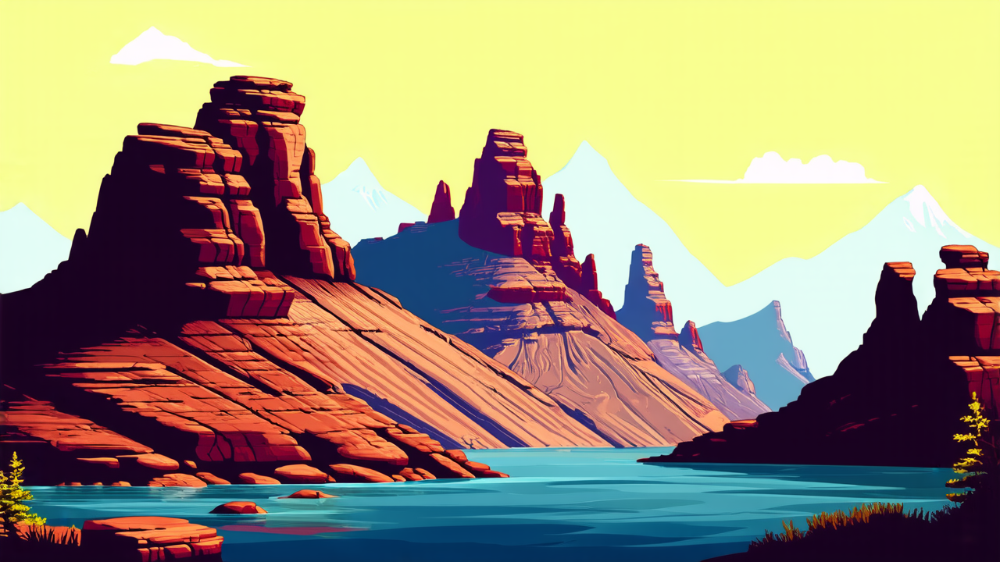

Generating image for prompt: Vector style landscape of a melancholic beachy, flat design, pastel colors, and simple shapes.


  0%|          | 0/50 [00:00<?, ?it/s]

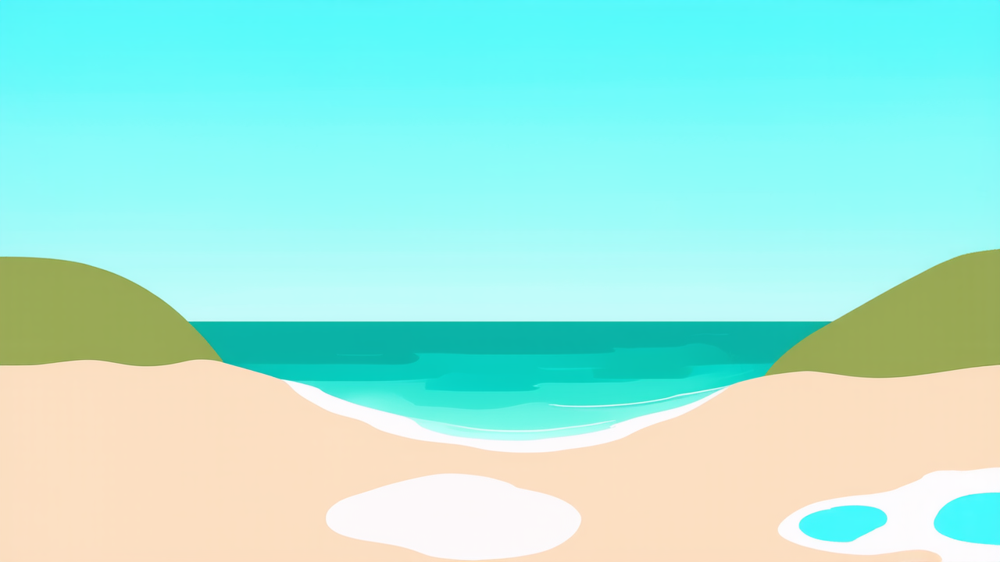

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a calm atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

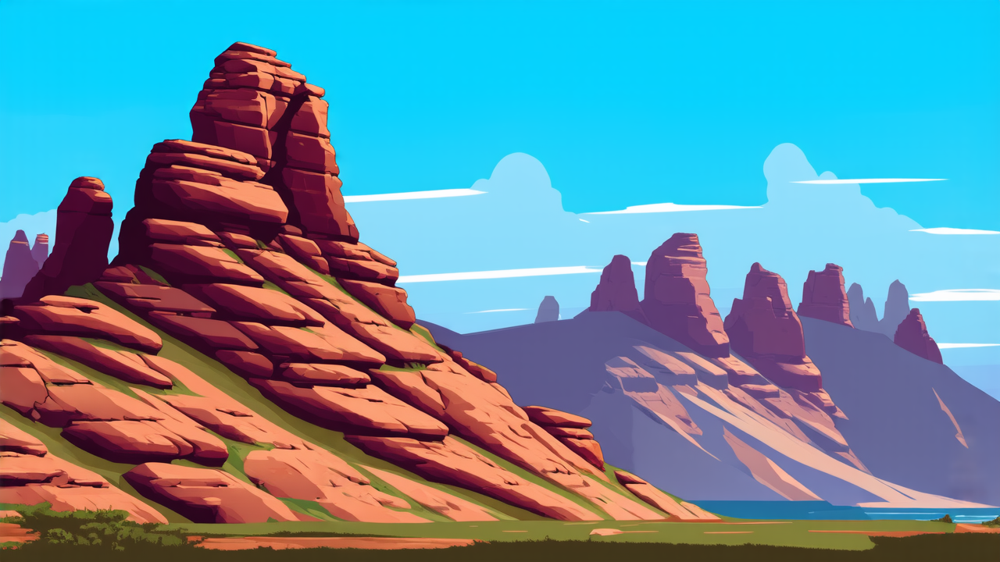

Generating image for prompt: Vector style image of a volcanic range, flat design, cool colors, and a peaceful atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

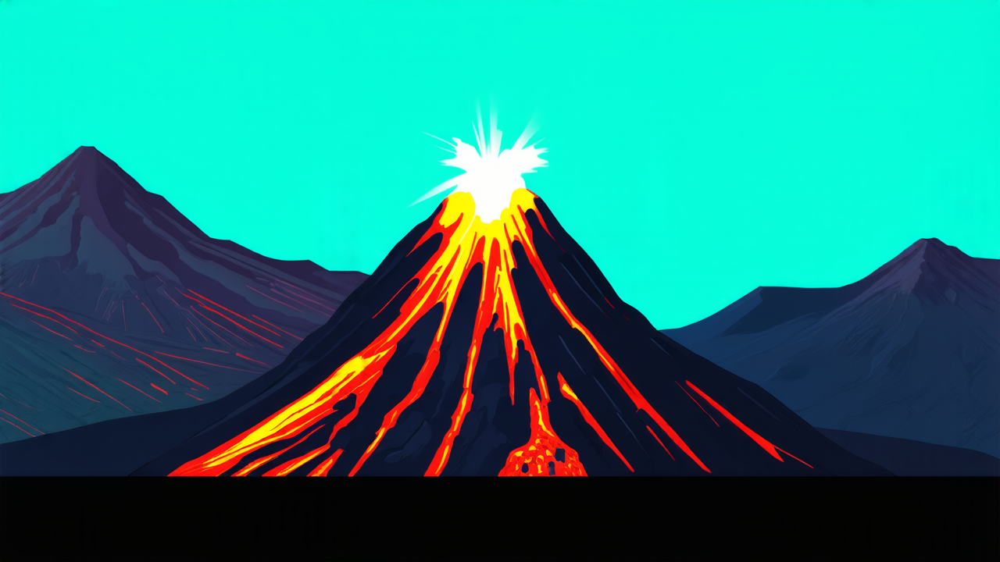

Generating image for prompt: Vector style image of a arctic range, flat design, cool colors, and a energetic atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

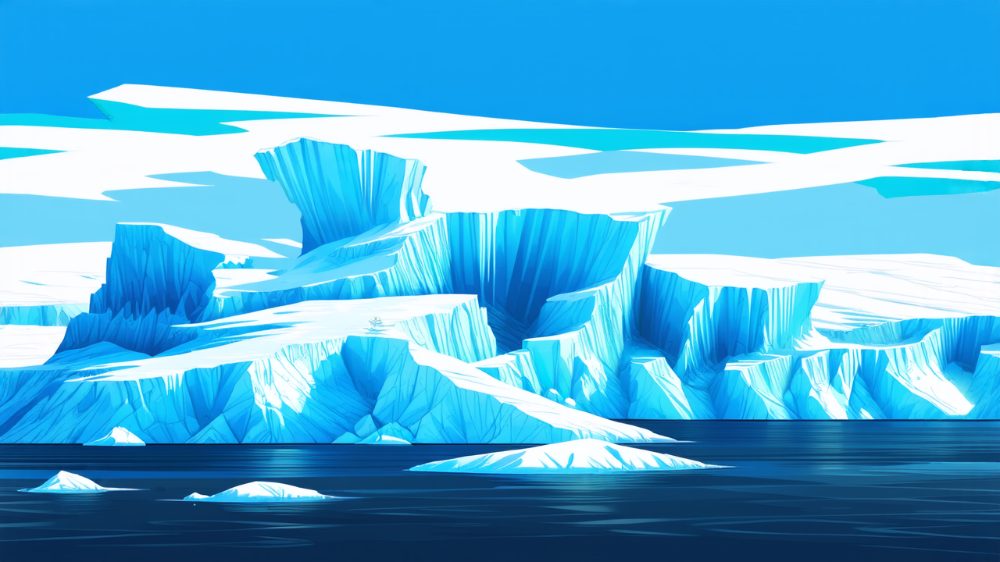

Generating image for prompt: Vector style image of a rocky range, flat design, cool colors, and a moody atmosphere.


  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
base_path = os.path.join(os.getcwd(), "drive", "MyDrive", "generated_images")
if not os.path.exists(base_path):
  os.makedirs(base_path)

# Define style image
list_images = ["montain", "snowy", "rocky", "desert", "tropical", "beachy", "forest", "outer space", "sky"]
list_atmosphere = ["serene", "peaceful", "mysterious", "dreamy", "vibrant", "moody", "dramatic", "calm", "energetic", "whimsical", "melancholic", "adventurous"]
list_prompt = [
  "Vector style landscape of a {} {}, flat design, pastel colors, and simple shapes.",
  "Vector style image of a {} range, flat design, cool colors, and a {} atmosphere.",
  "{} landscape background in minimalist style, with simple shapes and muted tones."
]

while True:
  prompt_template = random.choice(list_prompt)

  if prompt_template == list_prompt[0]:
    prompt = prompt_template.format(random.choice(list_atmosphere), random.choice(list_images))
  elif prompt_template == list_prompt[1]:
    prompt = prompt_template.format(random.choice(list_images), random.choice(list_atmosphere))
  else:
    prompt = prompt_template.format(random.choice(list_images))

  image_path = f"{base_path}/gpu_generated_image_{datetime.datetime.now().strftime('%Y%m%d%H%M%S')}.png"
  generate_image(pipe, prompt, image_path)

  display(Image(filename=image_path))